<a href="https://colab.research.google.com/github/Tomtechno/Tensorflow/blob/main/Copy_of_Segundo_Parcial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Red convolucional para detección de objetos con bounding boxes

Imports

In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14112, done.
remote: Counting objects: 100% (329/329), done.
remote: Compressing objects: 100% (200/200), done.
remote: Total 14112 (delta 218), reused 197 (delta 129), pack-reused 13783
Receiving objects: 100% (14112/14112), 13.64 MiB | 31.03 MiB/s, done.
Resolving deltas: 100% (9660/9660), done.
/content/yolov5
     |████████████████████████████████| 182 kB 6.9 MB/s 
     |████████████████████████████████| 63 kB 1.7 MB/s 
     |████████████████████████████████| 1.6 MB 59.6 MB/s 
     |████████████████████████████████| 41 kB 526 kB/s 
     |████████████████████████████████| 67 kB 3.9 MB/s 
     |████████████████████████████████| 145 kB 47.0 MB/s 
     |████████████████████████████████| 178 kB 63.8 MB/s 
     |████████████████████████████████| 54 kB 3.0 MB/s 
     |████████████████████████████████| 138 kB 62.3 MB/s 
     |████████████████████████████████| 62 kB 1.4 MB/s 
Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


Descompresion de datos

# Cargamos el modelo

In [2]:
from google.colab import drive
drive.mount('/content/drive')
%cd
%ls

Mounted at /content/drive
/root


In [ ]:
#Descargo los pesos a mi Drive
#1-Donde esta lo que quiero guardar. 2-Donde lo quiero guardar.
#%cp /content/yolov5/runs/exp0_yolov5s_results/weights/best.pt /content/drive/My\ Drive

#Subo los pesos a mi Colab
#%cp /content/drive/My\ Drive/best.pt /content/yolov5/weights

In [3]:
!unzip -q /content/drive/My\ Drive/datos_colab/cards.v2i.yolov5pytorch.zip -d/content/

In [5]:
%cp /content/drive/My\ Drive/datos_colab/best.pt /content
%ls

In [6]:
%cd ../content/yolov5
%ls

/content/yolov5
benchmarks.py    detect.py   models/           setup.cfg       val.py
classify/        export.py   README.md         train.py
CONTRIBUTING.md  hubconf.py  requirements.txt  tutorial.ipynb
data/            LICENSE     segment/          utils/


Cambiar el path de data.yaml por:

train: /content/train/images

val: /content/valid/images

test: /content/test/images

O sino pasar las carpetas de datos a datasets/roboflow, 


Etiquetas no anda, nose porque

train: /content/train/images
val: /content/valid/images
test: /content/test/images

In [8]:
!python train.py --freeze 10 --img 720 --batch 16 --epochs 60 --data /content/data.yaml --weights /content/best.pt --cache 

train: weights=/content/best.pt, cfg=, data=/content/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=60, batch_size=16, imgsz=720, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[10], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-267-gbe348cc Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7

In [9]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [10]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 720 --conf 0.1 --source /content/test/images

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/test/images, data=data/coco128.yaml, imgsz=[720, 720], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-267-gbe348cc Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 21059025 parameters, 0 gradients, 48.5 GFLOPs
WARNING ⚠️ --img-size [720, 720] must be multiple of max stride 32, updating to [736, 736]
image 1/85 /content/test/images/000554394_jpg.rf.7833e20bf764f8c46de566704bbcb6c0.jpg: 736x736 2 2ds, 1 2h, 1 3d, 1 8s, 35.3ms
image 2/85 /content/test/images/000807742_jpg.rf.b759bb3ab1a8de0e42fefa002a71666b.jpg: 736x736 2 2hs, 1 Ad, 3 A

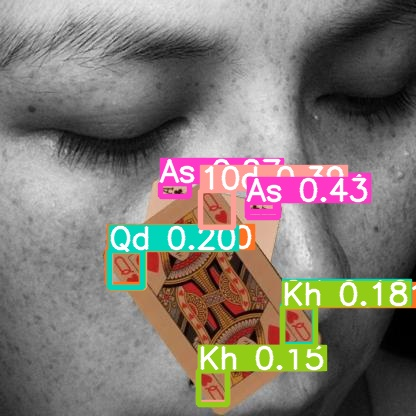

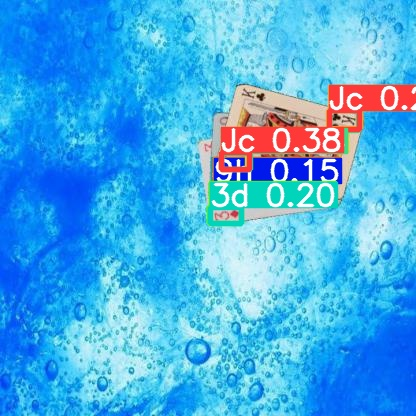

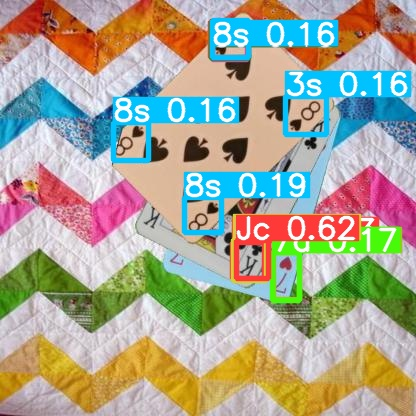

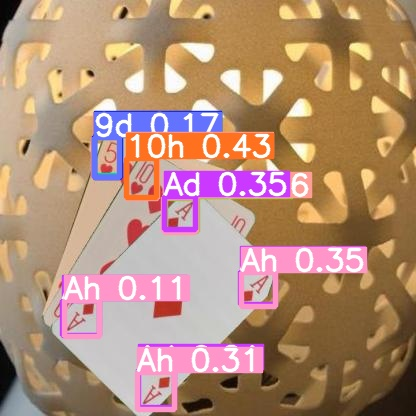

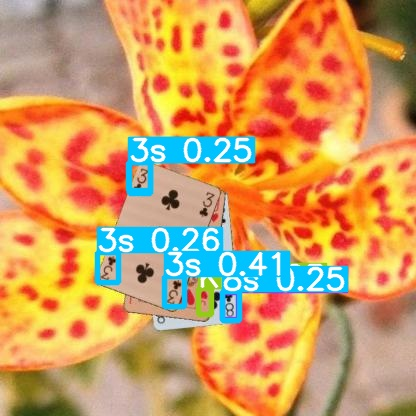

...

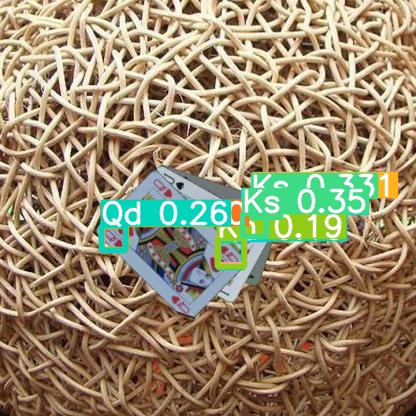

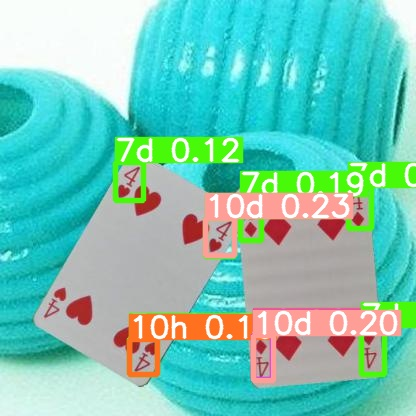

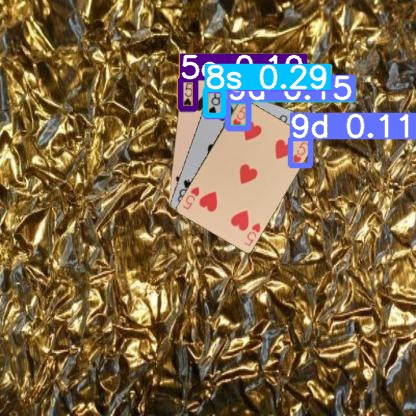

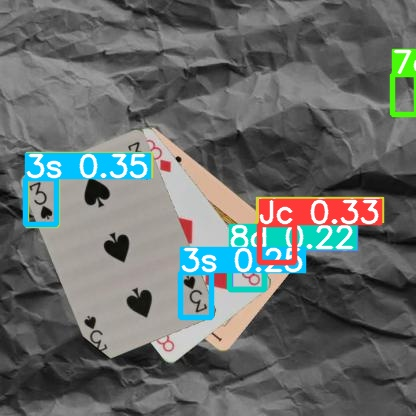

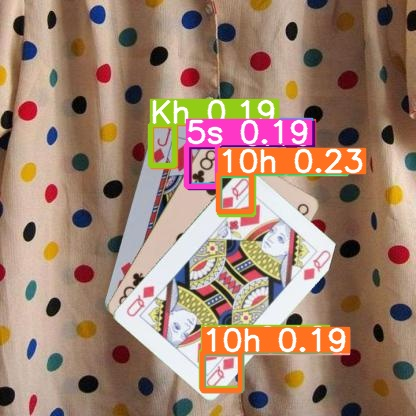

In [12]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [14]:
%reload_ext tensorboard
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 1778), started 0:02:23 ago. (Use '!kill 1778' to kill it.)

<IPython.core.display.Javascript object>

In [15]:
!python detect.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --img 720 --conf 0.1 --source /content/test/images

detect: weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], source=/content/test/images, data=data/coco128.yaml, imgsz=[720, 720], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-267-gbe348cc Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 21059025 parameters, 0 gradients, 48.5 GFLOPs
WARNING ⚠️ --img-size [720, 720] must be multiple of max stride 32, updating to [736, 736]
image 1/85 /content/test/images/000554394_jpg.rf.7833e20bf764f8c46de566704bbcb6c0.jpg: 736x736 2 2ds, 2 2hs, 1 3d, 1 5h, 1 8d, 1 8h, 1 8s, 36.1ms
image 2/85 /content/test/images/000807742_jpg.rf.b759bb3ab1a8de0e42fefa002a71666b.jpg: 736x

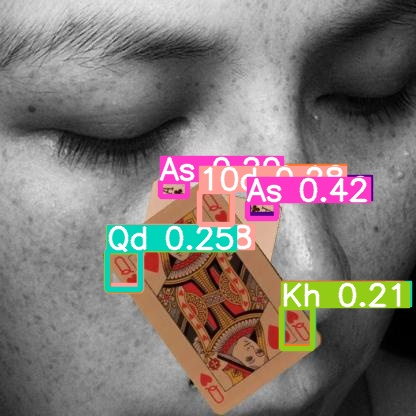

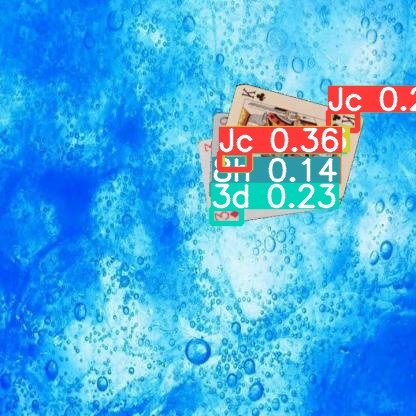

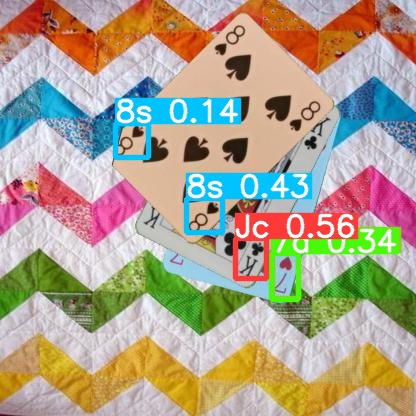

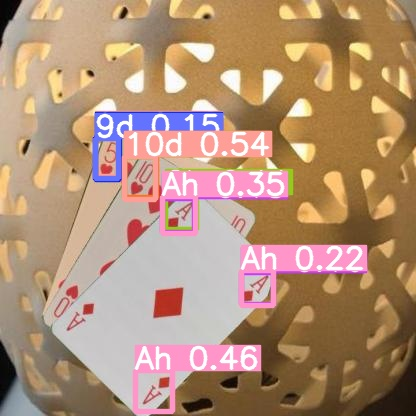

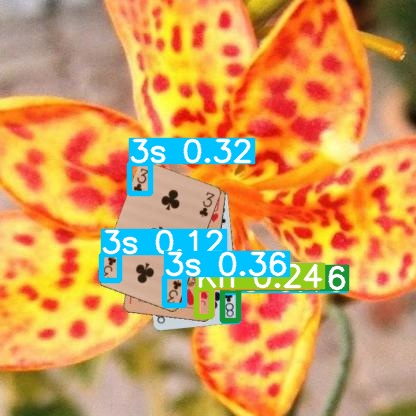

...

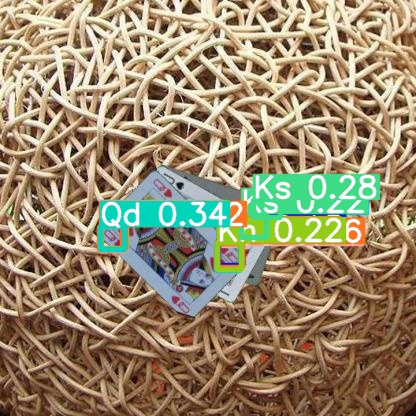

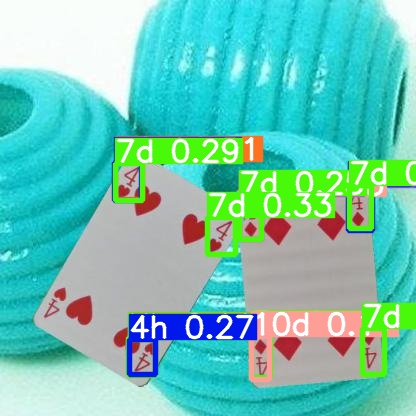

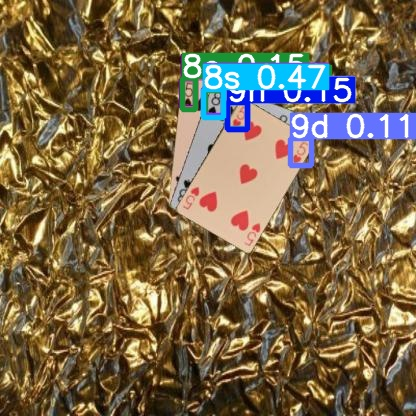

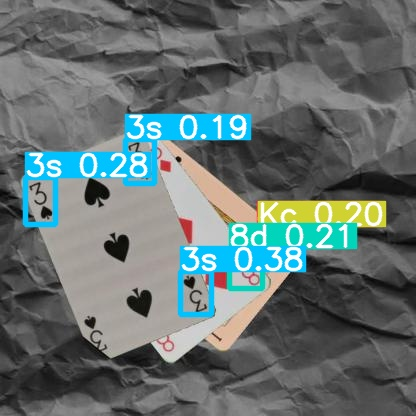

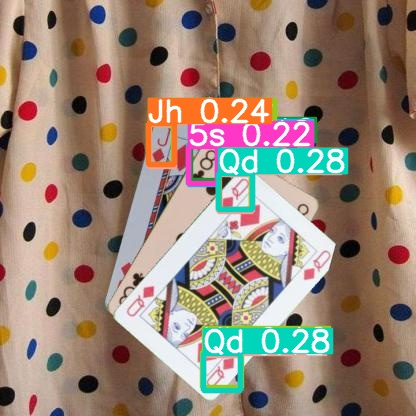

In [16]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [17]:
%reload_ext tensorboard
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 1778), started 0:07:05 ago. (Use '!kill 1778' to kill it.)

<IPython.core.display.Javascript object>